<a href="https://colab.research.google.com/github/peprick/SocialDistancingDetector/blob/main/social_disrtancing_detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import numpy as np
import cv2
import math
import time
from google.colab.patches import cv2_imshow
!git clone https://github.com/pjreddie/darknet
!wget https://pjreddie.com/media/files/yolov3.weights


Cloning into 'darknet'...
remote: Enumerating objects: 5934, done.
remote: Total 5934 (delta 0), reused 0 (delta 0), pack-reused 5934
Receiving objects: 100% (5934/5934), 6.35 MiB | 25.09 MiB/s, done.
Resolving deltas: 100% (3925/3925), done.
--2021-05-25 06:19:07--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights.2’

yolov3.weights.2    100%[===================>] 236.52M  40.5MB/s    in 6.2s    

2021-05-25 06:19:14 (37.9 MB/s) - ‘yolov3.weights.2’ saved [248007048/248007048]



In [4]:
#dnn->deep neural network
#yolov3 is our pretrained model which helps us to detect objects such as person in this case
net = cv2.dnn.readNet("yolov3.weights", "darknet/cfg/yolov3.cfg")
classes = ["person"]
with open("darknet/data/coco.names", "r") as f:
    classes = [line.strip() for line in f.readlines()]
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
np.random.uniform(0, 255, size=(len(classes),3))


#the sample video which is going to be our input is named as video.mp4
cap = cv2.VideoCapture('video.mp4')

True


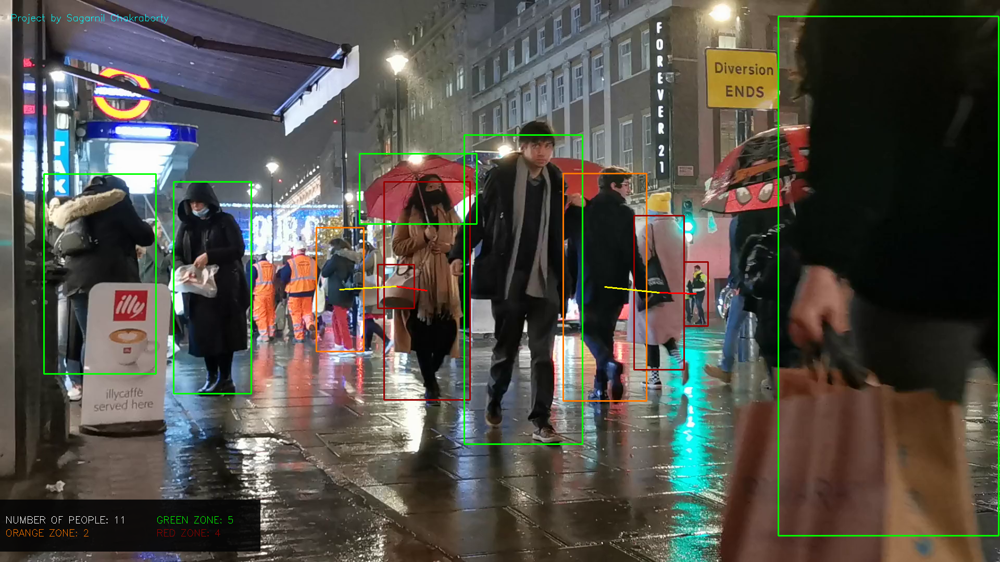

True


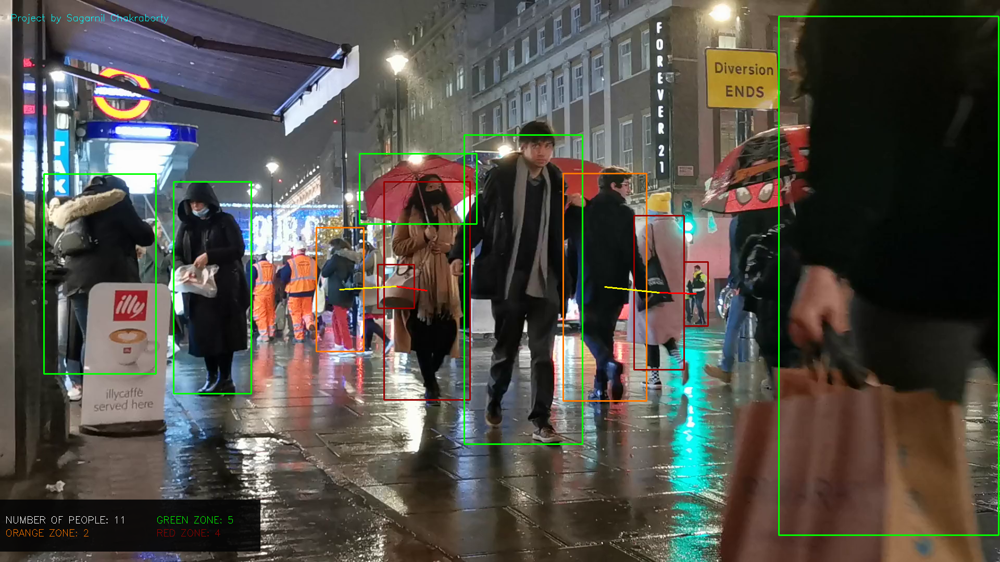

True


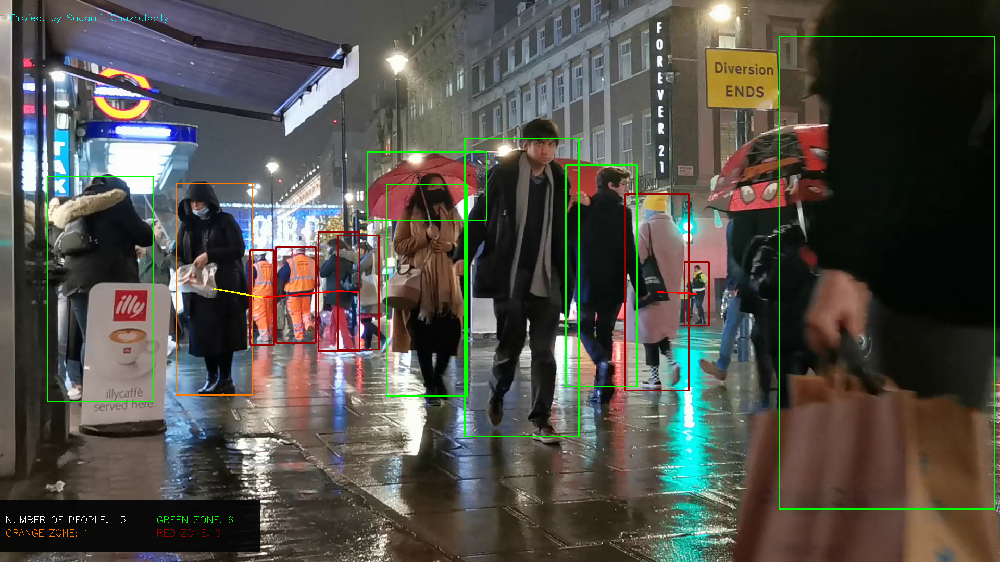

True


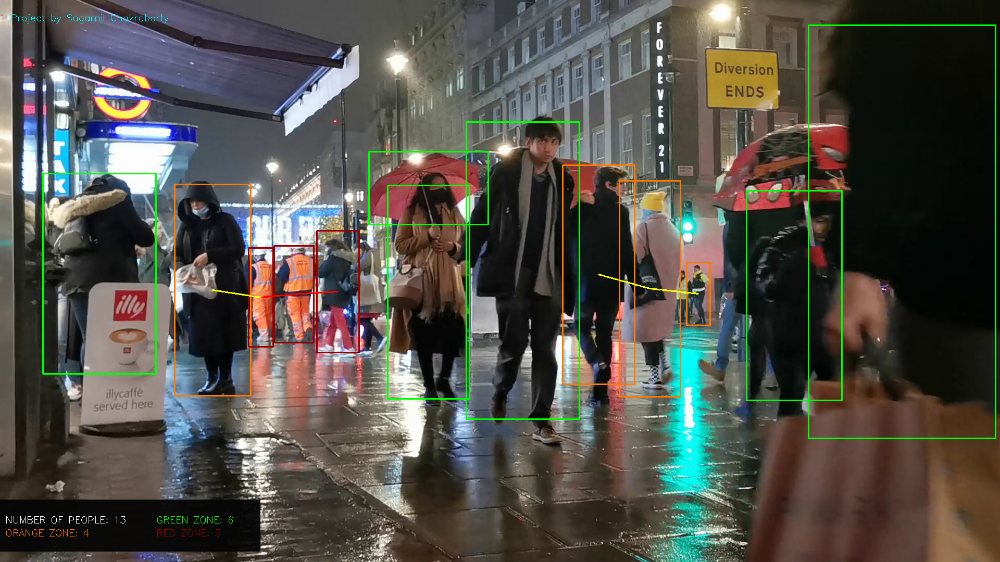

True


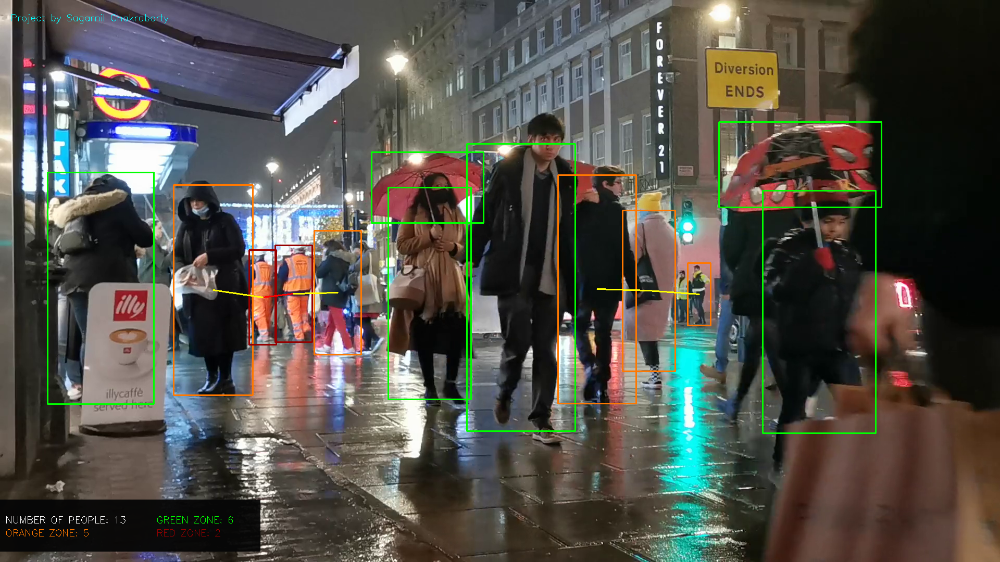

True


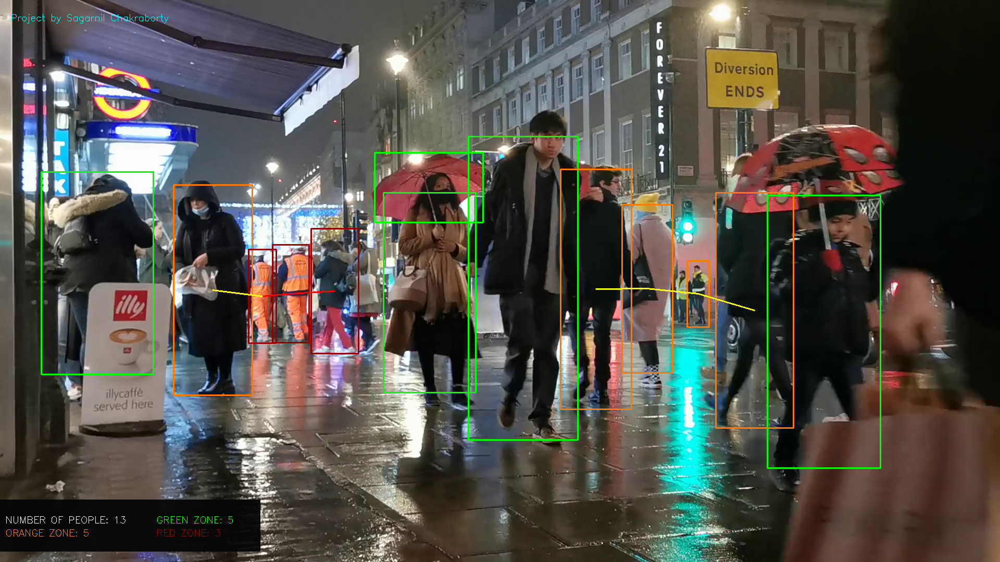

True


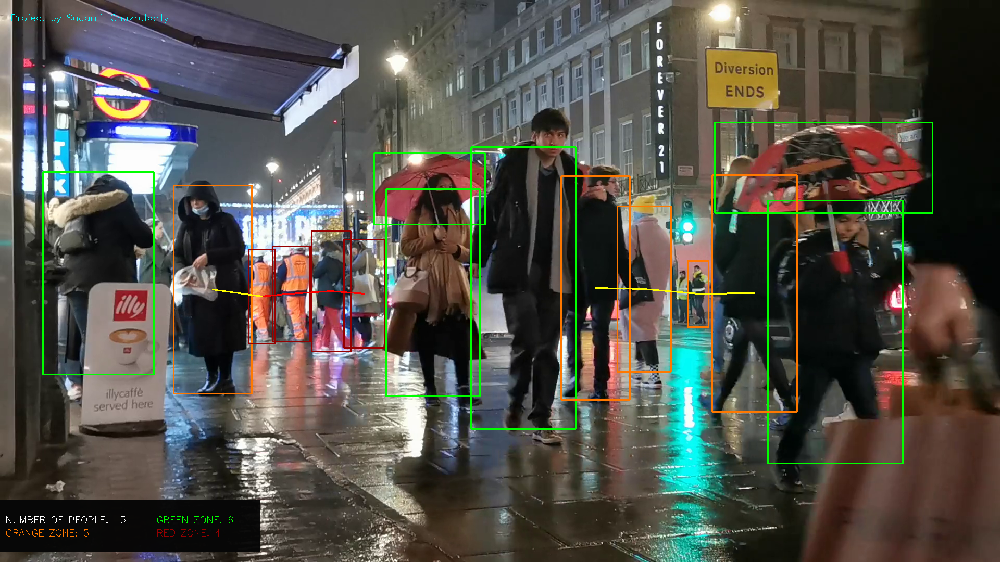

True


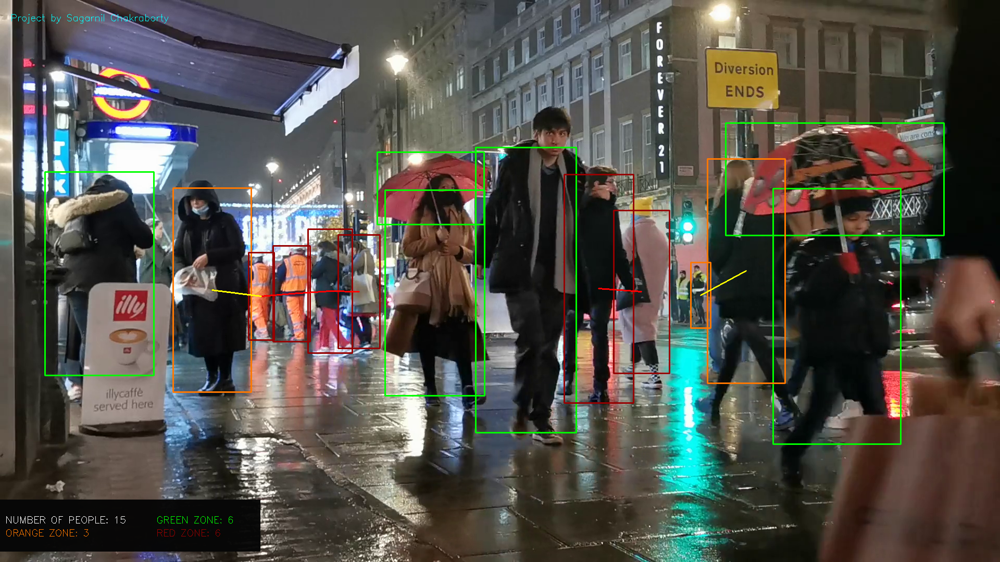

True


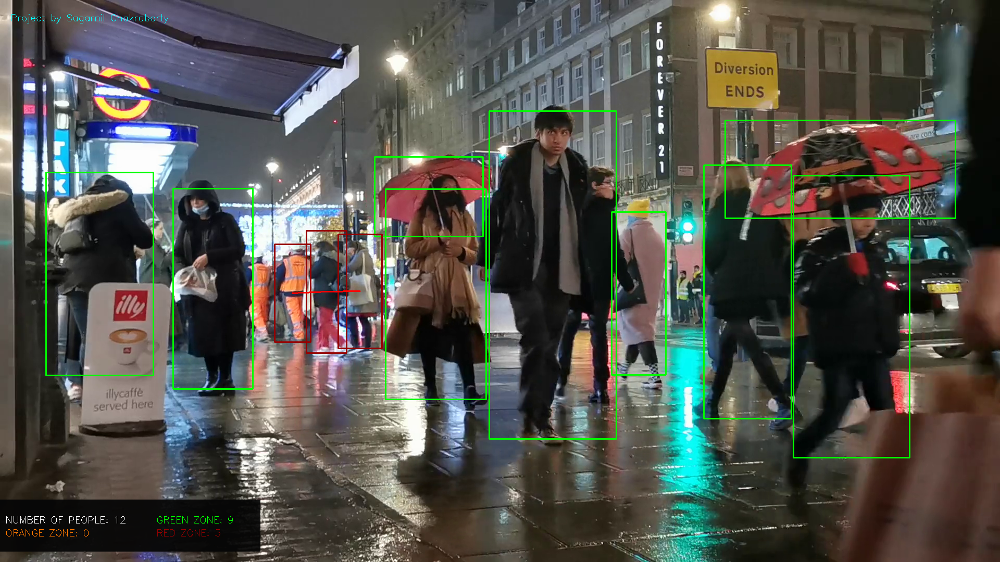

True


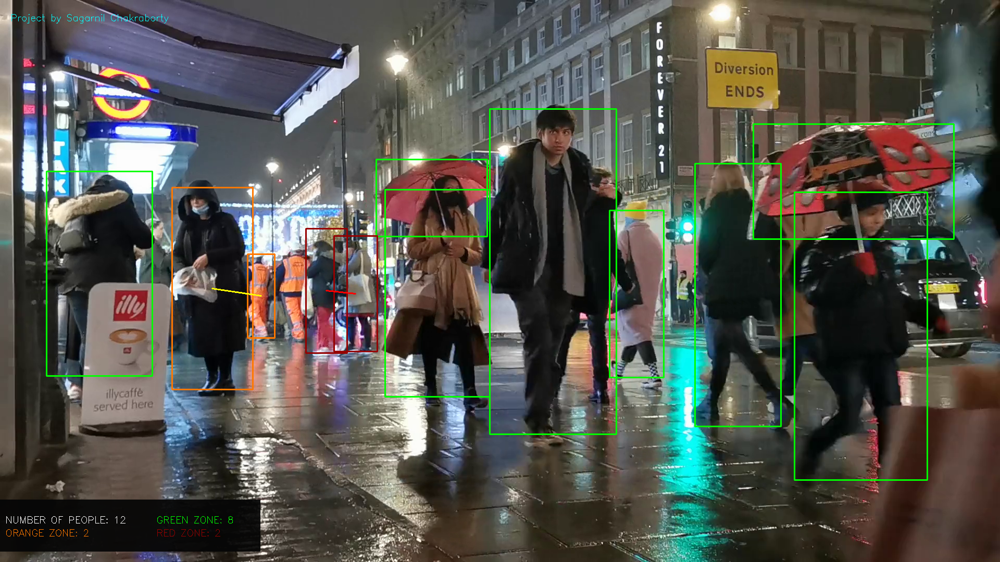

True


KeyboardInterrupt: ignored

In [5]:
#to find the euclidean distance between two points
def E_dist(p1, p2):
    return ((p1[0] - p2[0]) ** 2 +  (p1[1] - p2[1]) ** 2) ** 0.5

def isclose(p1, p2):
    c_d = E_dist(p1, p2)
    calib = (p1[1] + p2[1]) / 2
    #we have considered here 0.2 for medium distance, 0.15 for high risk or too close, and return 0 for no risk
    if 0 < c_d < 0.15 * calib:
        return 1
    elif 0 < c_d < 0.2 * calib:
        return 2
    else:
        return 0
    
height,width=(None,None)
q=0       
#we process  our video frame by frame
while(cap.isOpened()):
    ret, img = cap.read()  
    print(ret)
    if not ret:
        break
    if width is None or height is None: 
        height,width=img.shape[:2]
        q=width

    img =img[0:height, 0:q]
    height,width=img.shape[:2]

    # 0.00392 is the scaling
    #converting our image to a blob. Then we feed it into the neural network in the next line
    blob = cv2.dnn.blobFromImage(img,0.00392, (416, 416), (0,0,0), True, crop=False)
    net.setInput(blob)
    start = time.time()
    #outs has the final output from the output layers
    outs = net.forward(output_layers)
    end=time.time()
    #Showing informations on the screen
    
    #ids of the detected objects
    class_ids = []
    #confidence is the score of the respective ids. score > 0.5 is considered to be detecteed
    confidences = []
    #boxes has coordinates of rectangle to be drawn(top right and bottom left)
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            #0.5 is the threshold for confidence
            if confidence > 0.5:
                # Object detected
                #Purpose : Converts center coordinates to rectangle coordinates
                # x, y = midpoint of box
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                 # w, h = width, height of the box
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)
    #With this line we remove multiple boxes around the same object
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.5)
    #print(indexes)
    font = cv2.FONT_HERSHEY_SIMPLEX    
    if len(indexes)>0:        
        status=list() 
        #we flatten indexes array, i.e. multidimensional array to single dimensional       
        idf = indexes.flatten()        
        close_pair = list()        
        s_close_pair = list()        
        center = list()        
        dist = list()        
        for i in idf:            
            (x, y) = (boxes[i][0], boxes[i][1])            
            (w, h) = (boxes[i][2], boxes[i][3])            
            center.append([int(x + w / 2), int(y + h / 2)])            
            status.append(0)            
        for i in range(len(center)):            
            for j in range(len(center)):                
                #compare the closeness of two values
                g=isclose(center[i], center[j])      
                #we use status for keeping a record of the closeness of the class ids          
                if g ==1:                    
                    close_pair.append([center[i],center[j]])                    
                    status[i] = 1                    
                    status[j] = 1                    
                elif g == 2:                    
                    s_close_pair.append([center[i], center[j]])                    
                    if status[i] != 1:                        
                        status[i] = 2                        
                    if status[j] != 1:                        
                        status[j] = 2
        total_p = len(center)        
        low_risk_p = status.count(2)        
        high_risk_p = status.count(1)        
        safe_p = status.count(0)        
        kk = 0        
        for i in idf:   

            #I added my name on the top left corner :)
            cv2.putText(img, "Project by Sagarnil Chakraborty ", (20, 40),font, 0.6, (255, 255, 0), 1)      
            #now we add a section for showing the no. of people at risk
            tot_str = "NUMBER OF PEOPLE: " + str(total_p)            
            high_str = "RED ZONE: " + str(high_risk_p)            
            low_str = "ORANGE ZONE: " + str(low_risk_p)            
            safe_str = "GREEN ZONE: " + str(safe_p)            

            sub_img = img[height - 120:height-20, 0:500]

            black_rect = np.ones(sub_img.shape, dtype=np.uint8) * 0
            res = cv2.addWeighted(sub_img, 0.8, black_rect, 0.2, 1.0)
            img[height - 120:height-20, 0:500] = res
            cv2.putText(img, tot_str, (10, height - 75),font, 0.6, (255, 255, 255), 1)            
            cv2.putText(img, safe_str, (300, height - 75),font, 0.6, (0, 255, 0), 1)            
            cv2.putText(img, low_str, (10, height - 50),font, 0.6, (0, 120, 255), 1)            
            cv2.putText(img, high_str, (300, height - 50),font, 0.6, (0, 0, 150), 1)

            (x, y) = (boxes[i][0], boxes[i][1])            
            (w, h) = (boxes[i][2], boxes[i][3])        
            #color of the rectangle when is too close 
            if status[kk] == 1:                
                cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 150), 2)
            elif status[kk] == 0:                
                cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            else:
                cv2.rectangle(img, (x, y), (x + w, y + h), (0, 120, 255), 2)
            kk += 1
        for h in close_pair:            
            cv2.line(img, tuple(h[0]), tuple(h[1]), (0, 0, 255), 2)         
        for b in s_close_pair:
            cv2.line(img, tuple(b[0]), tuple(b[1]), (0, 255, 255), 2)

    #cv2_imshow is used here instead of cv2.imshow since this is supported in google colab
    cv2_imshow(img)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    cv2.waitKey(1)

    #FourCC code below is used to get the entire output as an output file.
    fourcc = cv2.VideoWriter_fourcc(*'MJPG')
    output = cv2.VideoWriter('output4.mp4',fourcc, 20.0, (img.shape[1], img.shape[0]))

    #cv2.imwrite("output1.mp4",img)

    #img = cv2.flip(img,0)

    output.write(img)
cap.release()
output.release()
cv2.destroyAllWindows()

#project by Sagarnil CHakraborty